# Imports and Constants

In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
from collections import defaultdict
import itertools
import pickle
import os
import sys

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import plotly_express as px
from tqdm import tqdm
import plotly
import kaleido
import plotly.io as pio
import scipy.stats as stats
from pyecharts.charts import Bar
from pyecharts import options as opts

sys.path.append('../')
from batchers import dataset_constants
from utils.analysis import (
    calc_score,
    chunk_vs_score,
    evaluate_df,
    evaluate,
    plot_chunk_vs_score,
    plot_label_vs_score,
    plot_percdata_vs_score,
    sorted_scores)
from utils.general import colordisplay, load_npz
from utils.plot import scatter_preds, symmetric_heatmap

In [3]:
OUTPUTS_ROOT_DIR = '../outputs'
PLOTS_DIR = os.path.join(OUTPUTS_ROOT_DIR,'dhs_ooc/results/plots/points')
os.makedirs(PLOTS_DIR, exist_ok=True)
MODEL_NAME_TO_DIR = {
    'PCA':{
        'MSI':{
            'Ridge': 'dhs_ooc/PCA_099/resnet_ms_pca099/ridge_logo_pca099/test_preds.npz',
            'RF': 'dhs_ooc/PCA_099/resnet_ms_pca099/RF_logo_pca099/RF_all_preds.csv',
            'XGBoost': 'dhs_ooc/PCA_099/resnet_ms_pca099/XGBoost_logo_pca099/XGBoost_all_preds_pca099.csv',
            'NGBoost': 'dhs_ooc/PCA_099/resnet_ms_pca099/NGB/NGBoost/95/point_preds.csv'
        },
        'NLI':{
            'Ridge': 'dhs_ooc/PCA_099/resnet_nl_pca099/ridge_logo_pca099/test_preds.npz',
            'RF': 'dhs_ooc/PCA_099/resnet_nl_pca099/RF_logo_pca099/RF_all_preds.csv',
            'XGBoost': 'dhs_ooc/PCA_099/resnet_nl_pca099/XGBoost_logo_pca099/XGBoost_all_preds_pca099.csv',
            'NGBoost': 'dhs_ooc/PCA_099/resnet_nl_pca099/NGB/NGBoost/95/point_preds.csv'
        },
        'MSNLI':{
            'Ridge': 'dhs_ooc/PCA_099/resnet_msnl_pca099/ridge_logo_pca099/test_preds.npz',
            'RF': 'dhs_ooc/PCA_099/resnet_msnl_pca099/RF_logo_pca099/RF_all_preds.csv',
            'XGBoost': 'dhs_ooc/PCA_099/resnet_msnl_pca099/XGBoost_logo_pca099/XGBoost_all_preds_pca099.csv',
            'NGBoost': 'dhs_ooc/PCA_099/resnet_msnl_pca099/NGB/NGBoost/95/point_preds.csv'
        }
    },
    'UMAP':{
        'MSI':{
            'Ridge': 'dhs_ooc/UMAP/resnet_ms_UMAP/ridge_logo_UMAP/test_preds.npz',
            'RF': 'dhs_ooc/UMAP/resnet_ms_UMAP/RF_logo_UMAP/RF_all_preds.csv',
            'XGBoost': 'dhs_ooc/UMAP/resnet_ms_UMAP/XGBoost_logo_UMAP/XGBoost_all_preds_UMAP.csv',
            'NGBoost': 'dhs_ooc/UMAP/resnet_ms_UMAP/NGB/NGBoost/95/point_preds.csv'
        },
        'NLI':{
            'Ridge': 'dhs_ooc/UMAP/resnet_nl_UMAP/ridge_logo_UMAP/test_preds.npz',
            'RF': 'dhs_ooc/UMAP/resnet_nl_UMAP/RF_logo_UMAP/RF_all_preds.csv',
            'XGBoost': 'dhs_ooc/UMAP/resnet_nl_UMAP/XGBoost_logo_UMAP/XGBoost_all_preds_UMAP.csv',
            'NGBoost': 'dhs_ooc/UMAP/resnet_nl_UMAP/NGB/NGBoost/95/point_preds.csv'
        },
        'MSNLI':{
            'Ridge': 'dhs_ooc/UMAP/resnet_msnl_UMAP/ridge_logo_UMAP/test_preds.npz',
            'RF': 'dhs_ooc/UMAP/resnet_msnl_UMAP/RF_logo_UMAP/RF_all_preds.csv',
            'XGBoost': 'dhs_ooc/UMAP/resnet_msnl_UMAP/XGBoost_logo_UMAP/XGBoost_all_preds_UMAP.csv',
            'NGBoost': 'dhs_ooc/UMAP/resnet_msnl_UMAP/NGB/NGBoost/95/point_preds.csv'
        }
    },
    'The raw':{
        'MSI':{
            'Resnet': 'dhs_ooc/raw/resnet_ms/resnet_ms_preds.csv',
            'Ridge': 'dhs_ooc/raw/resnet_ms/ridge_logo/test_preds.npz'
        },
        'NLI':{
            'Resnet': 'dhs_ooc/raw/resnet_nl/resnet_nl_preds.csv',
            'Ridge': 'dhs_ooc/raw/resnet_nl/ridge_logo/test_preds.npz'
        },
        'MSNLI':{
            'Ridge': 'dhs_ooc/raw/resnet_msnl/ridge_logo/test_preds.npz'
        }
    }
}

In [4]:
dhs_clusters_19047 = pd.read_csv('../data/dhs_clusters_19047.csv')
country = np.array(dhs_clusters_19047['country'])
lat = np.array(dhs_clusters_19047['lat'])
lon = np.array(dhs_clusters_19047['lon'])
labels = np.array(dhs_clusters_19047['wealthpooled'])
df = pd.DataFrame({'country': country,
                   'lat': lat,
                   'lon': lon,
                   'labels': labels})

In [5]:
def sum_all_point_preds():
    dhs_clusters_19047 = pd.read_csv('../data/dhs_clusters_19047.csv')
    country = np.array(dhs_clusters_19047['country'])
    lat = np.array(dhs_clusters_19047['lat'])
    lon = np.array(dhs_clusters_19047['lon'])
    labels = np.array(dhs_clusters_19047['wealthpooled'])
    df = pd.DataFrame({'country': country, 'lat': lat, 'lon': lon, 'labels': labels})
    for reduction, reduction_info in MODEL_NAME_TO_DIR.items():
        for image_type, image_type_info in reduction_info.items():
            for point_method, path in image_type_info.items():
                method =  reduction + '_' + image_type + '_' + point_method
                if point_method == 'Ridge':
                    preds = pd.DataFrame(load_npz(os.path.join(OUTPUTS_ROOT_DIR,path))['test_preds'])
                if point_method == 'NGBoost':
                    preds = pd.read_csv(os.path.join(OUTPUTS_ROOT_DIR,path),header = None)
                if point_method == 'Resnet':
                    preds = pd.read_csv(os.path.join(OUTPUTS_ROOT_DIR,path))
                if point_method == 'RF':
                    preds = pd.read_csv(os.path.join(OUTPUTS_ROOT_DIR,path))
                if point_method == 'XGBoost':
                    preds = pd.read_csv(os.path.join(OUTPUTS_ROOT_DIR,path))
                df[method] = np.array(preds)
    return df

In [6]:
all_point_preds = sum_all_point_preds()
all_point_preds

locs: dtype=float32, shape=(19047, 2)
labels: dtype=float32, shape=(19047,)
test_preds: dtype=float32, shape=(19047,)
locs: dtype=float32, shape=(19047, 2)
labels: dtype=float32, shape=(19047,)
test_preds: dtype=float32, shape=(19047,)
locs: dtype=float32, shape=(19047, 2)
labels: dtype=float32, shape=(19047,)
test_preds: dtype=float32, shape=(19047,)
locs: dtype=float32, shape=(19047, 2)
labels: dtype=float32, shape=(19047,)
test_preds: dtype=float32, shape=(19047,)
locs: dtype=float32, shape=(19047, 2)
labels: dtype=float32, shape=(19047,)
test_preds: dtype=float32, shape=(19047,)
locs: dtype=float32, shape=(19047, 2)
labels: dtype=float32, shape=(19047,)
test_preds: dtype=float32, shape=(19047,)
locs: dtype=float32, shape=(19047, 2)
labels: dtype=float32, shape=(19047,)
test_preds: dtype=float32, shape=(19047,)
locs: dtype=float32, shape=(19047, 2)
labels: dtype=float32, shape=(19047,)
test_preds: dtype=float32, shape=(19047,)
locs: dtype=float32, shape=(19047, 2)
labels: dtype=floa

,country,lat,lon,labels,PCA_MSI_Ridge,PCA_MSI_RF,PCA_MSI_XGBoost,PCA_MSI_NGBoost,PCA_NLI_Ridge,PCA_NLI_RF,...,UMAP_NLI_NGBoost,UMAP_MSNLI_Ridge,UMAP_MSNLI_RF,UMAP_MSNLI_XGBoost,UMAP_MSNLI_NGBoost,The raw_MSI_Resnet,The raw_MSI_Ridge,The raw_NLI_Resnet,The raw_NLI_Ridge,The raw_MSNLI_Ridge
0,angola,-12.350257,13.534922,2.595618,0.937552,0.999629,1.024798,1.012695,1.174918,1.085085,...,1.012000,1.134719,1.053667,1.116931,1.115793,0.904103,0.969657,1.293621,1.142054,1.089906
1,angola,-12.360865,13.551494,2.209620,1.202666,1.118453,1.237899,1.161994,1.209413,1.188379,...,1.156909,1.217024,1.168783,1.195977,1.174658,1.133152,1.178214,1.330735,1.184240,1.175488
2,angola,-12.613421,13.413085,0.906469,0.642409,0.926218,0.658739,0.723281,1.184153,1.091081,...,1.087404,0.953516,1.058092,1.023770,1.038170,0.608178,0.583152,1.303556,1.153975,0.927088
3,angola,-12.581454,13.397711,1.105359,1.032377,1.128050,1.099800,1.058819,1.237919,1.229990,...,1.218767,1.167642,1.170490,1.182879,1.155687,0.974350,1.252927,1.361404,1.218019,1.243368
4,angola,-12.578135,13.418748,1.879344,1.006104,1.058289,1.066280,1.058819,1.213663,1.189333,...,1.155466,1.148967,1.161651,1.157044,1.147581,0.948029,1.157067,1.335292,1.186630,1.198779
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19042,zimbabwe,-17.915288,31.156115,0.237659,0.952837,1.031607,0.922327,1.003709,0.848721,0.802115,...,0.790619,0.882630,1.018014,0.874840,0.938143,1.181631,0.988871,0.772609,0.844742,0.959548
19043,zimbabwe,-18.379501,31.872287,0.492502,-0.381289,-0.394468,-0.265400,-0.393535,-0.103699,-0.110580,...,-0.103792,-0.179502,-0.339198,-0.270903,-0.241926,-0.288686,-0.537071,-0.099085,-0.113433,-0.232575
19044,zimbabwe,-16.660612,29.850649,-0.088922,-0.459815,-0.418072,-0.295051,-0.413699,-0.335786,-0.348314,...,-0.359367,-0.410219,-0.380444,-0.382741,-0.378334,-0.375234,-0.445385,-0.311705,-0.339286,-0.387330
19045,zimbabwe,-17.914251,30.956975,1.613829,1.060861,1.156707,1.089401,1.159807,1.206369,1.242611,...,1.216291,1.167850,1.255619,1.128987,1.190438,1.287999,1.185053,1.099678,1.214682,1.156893


In [7]:
MODEL_NAMES = list(all_point_preds.columns[(all_point_preds.columns != 'country') & 
                                           (all_point_preds.columns != 'lat') & 
                                           (all_point_preds.columns != 'lon') &
                                           (all_point_preds.columns != 'labels')])

In [8]:
country_df = (
    all_point_preds
    .groupby(['country'])
    .apply(evaluate_df, cols=MODEL_NAMES, index_name='model'))
country_df = country_df.reset_index()
for i in range(country_df.shape[0]):
    country_df.loc[i,'reduction']=country_df.loc[i,'model'].split('_')[0]
    country_df.loc[i,'image_type']=country_df.loc[i,'model'].split('_')[1]
    country_df.loc[i,'point_method']=country_df.loc[i,'model'].split('_')[2]
country_df

,country,model,r2,R2,MSE,MAE,rank,reduction,image_type,point_method
0,angola,PCA_MSI_Ridge,0.694447,0.655063,0.411834,0.525465,0.803634,PCA,MSI,Ridge
1,angola,PCA_MSI_RF,0.692918,0.665005,0.399965,0.512023,0.801713,PCA,MSI,RF
2,angola,PCA_MSI_XGBoost,0.694017,0.665780,0.399039,0.512585,0.804374,PCA,MSI,XGBoost
3,angola,PCA_MSI_NGBoost,0.692842,0.663780,0.401427,0.513825,0.802506,PCA,MSI,NGBoost
4,angola,PCA_NLI_Ridge,0.759579,0.708006,0.348624,0.488261,0.843376,PCA,NLI,Ridge
...,...,...,...,...,...,...,...,...,...,...
662,zimbabwe,The raw_MSI_Resnet,0.674177,0.586128,0.351012,0.464527,0.773839,The raw,MSI,Resnet
663,zimbabwe,The raw_MSI_Ridge,0.688047,0.444954,0.470744,0.543781,0.785289,The raw,MSI,Ridge
664,zimbabwe,The raw_NLI_Resnet,0.769131,0.560058,0.373122,0.481820,0.844860,The raw,NLI,Resnet
665,zimbabwe,The raw_NLI_Ridge,0.768202,0.592892,0.345276,0.463386,0.844852,The raw,NLI,Ridge


In [26]:
def point_plot(plot_name, data, indicator, title, legend_loc):
    sns.set(style='white',font_scale=1.6)
    plot = sns.violinplot(x='model', y=indicator, hue='reduction', data=data, dodge=False, scale = 'area', palette = "YlGnBu")
    plot.margins(y=0.1)

    plot.set_xticklabels(labels = list({}.fromkeys(data['model']).keys()), rotation = 90,fontsize = 20)
    plot.legend(loc = legend_loc)
    
    if indicator == 'r2':
        plot.set_title(title,fontsize=28)
    plot.yaxis.label.set_size(30)
    if indicator != 'rank':
        plot.axes.get_xaxis().set_visible(False)

    if indicator != 'rank':
        plt.xticks([])  # 去掉横坐标值 
    if indicator == 'r2':
        plt.ylabel("r\u00b2")
        plt.ylim(0,1)
    if indicator == 'R2':
        plt.ylabel("R\u00b2")
        plt.ylim(0,1)
    if indicator == 'MSE':
        plt.ylim(0,0.7)
    if indicator == 'MAE':
        plt.ylim(0,0.7)
    if indicator == 'rank':
        plt.ylim(0.3,1)
    plt.savefig(os.path.join(PLOTS_DIR,'violin_'+plot_name+'.png'),dpi=500,bbox_inches = 'tight')
    plt.show()

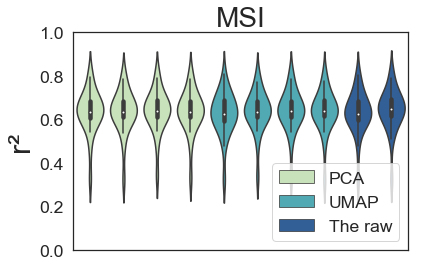

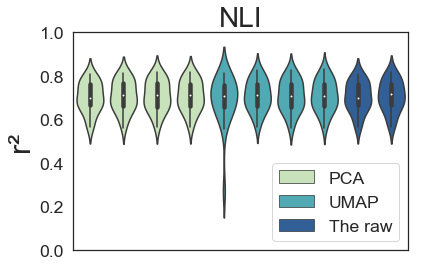

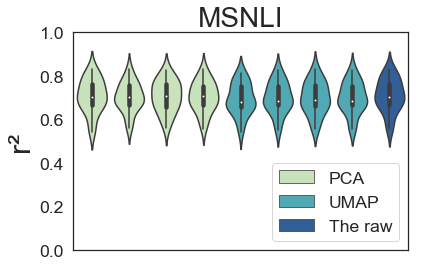

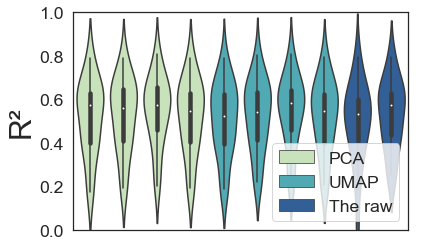

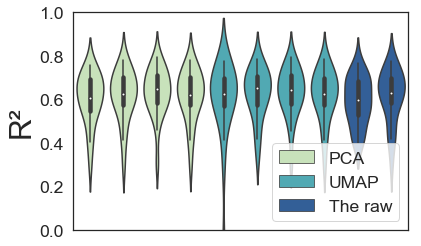

...

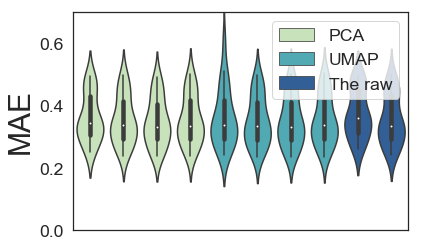

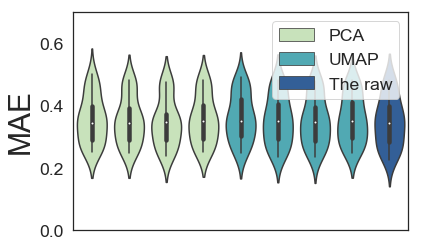

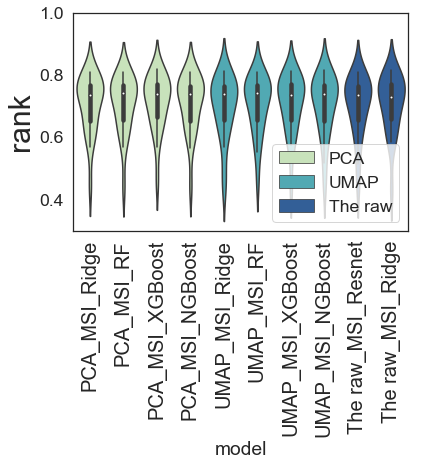

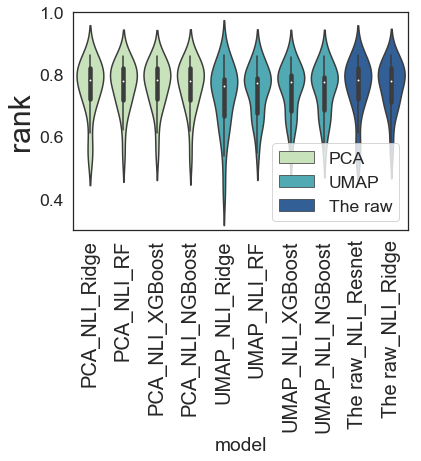

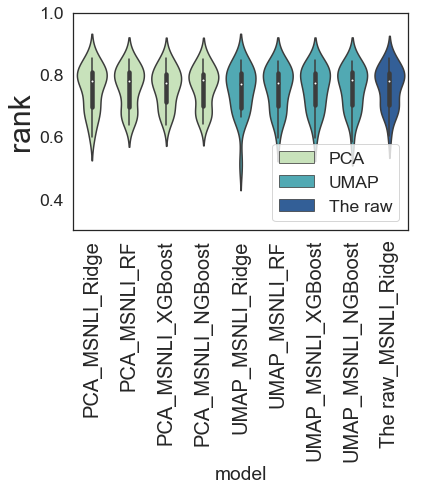

In [27]:
df_ms = country_df[(country_df['image_type']=='MSI')]
df_nl = country_df[(country_df['image_type']=='NLI')]
df_msnl = country_df[(country_df['image_type']=='MSNLI')]

point_plot(plot_name = 'r2_ms', data = df_ms, indicator = 'r2', title = 'MSI', legend_loc = 'lower right')
point_plot(plot_name = 'r2_nl', data = df_nl, indicator = 'r2', title = 'NLI', legend_loc = 'lower right')
point_plot(plot_name = 'r2_msnl', data = df_msnl, indicator = 'r2', title = 'MSNLI', legend_loc = 'lower right')

point_plot(plot_name = 'ms_R2', data = df_ms, indicator = 'R2', title = 'MSI', legend_loc = 'lower right')
point_plot(plot_name = 'nl_R2', data = df_nl, indicator = 'R2', title = 'NLI', legend_loc = 'lower right')
point_plot(plot_name = 'msnl_R2', data = df_msnl, indicator = 'R2', title = 'MSNLI', legend_loc = 'lower right')

point_plot(plot_name = 'ms_MSE', data = df_ms, indicator = 'MSE', title = 'MSI', legend_loc = 'upper right')
point_plot(plot_name = 'nl_MSE', data = df_nl, indicator = 'MSE', title = 'NLI', legend_loc = 'upper right')
point_plot(plot_name = 'msnl_MSE', data = df_msnl, indicator = 'MSE', title = 'MSNLI', legend_loc = 'upper right')

point_plot(plot_name = 'ms_MAE', data = df_ms, indicator = 'MAE', title = 'MSI', legend_loc = 'upper right')
point_plot(plot_name = 'nl_MAE', data = df_nl, indicator = 'MAE', title = 'NLI', legend_loc = 'upper right')
point_plot(plot_name = 'msnl_MAE', data = df_msnl, indicator = 'MAE', title = 'MSNLI', legend_loc = 'upper right')

point_plot(plot_name = 'ms_rank', data = df_ms, indicator = 'rank', title = 'MSI', legend_loc = 'lower right')
point_plot(plot_name = 'nl_rank', data = df_nl, indicator = 'rank', title = 'NLI', legend_loc = 'lower right')
point_plot(plot_name = 'msnl_rank', data = df_msnl, indicator = 'rank', title = 'MSNLI', legend_loc = 'lower right')

# 四、计算r2、R2、MSE、MAE、rank

### 1、所有样本的R2

In [11]:
labels = all_point_preds['labels']
cols = MODEL_NAMES
records = []
for col in cols:
    row = evaluate(labels=labels, preds=all_point_preds[col])
    records.append(row)
index_name='model'
index = pd.Index(data=cols, name=index_name)
results_df = pd.DataFrame.from_records(
    records, columns=['r2', 'R2', 'mse', 'mae', 'rank'], index=index)
sort_df = results_df.sort_values(by='R2', ascending=False).round(3)
sort_df

,r2,R2,mse,mae,rank
model,,,,,
PCA_NLI_XGBoost,0.687,0.682,0.206,0.351,0.800
UMAP_NLI_XGBoost,0.685,0.680,0.207,0.352,0.800
PCA_MSNLI_XGBoost,0.680,0.679,0.208,0.350,0.779
The raw_MSNLI_Ridge,0.677,0.677,0.209,0.349,0.773
UMAP_NLI_RF,0.676,0.675,0.211,0.354,0.764
UMAP_MSNLI_XGBoost,0.674,0.673,0.212,0.354,0.776
PCA_MSNLI_RF,0.672,0.671,0.213,0.354,0.771
UMAP_MSNLI_RF,0.672,0.671,0.213,0.356,0.767
PCA_MSNLI_Ridge,0.669,0.669,0.214,0.355,0.759


### 2、各个国家R2的平均值

In [12]:
country_df.groupby('model').mean().sort_values(by='R2', ascending=False).round(3)

,r2,R2,MSE,MAE,rank
model,,,,,
PCA_NLI_XGBoost,0.708,0.634,0.200,0.347,0.765
UMAP_NLI_XGBoost,0.707,0.632,0.202,0.349,0.749
PCA_MSNLI_XGBoost,0.707,0.628,0.203,0.346,0.759
UMAP_NLI_RF,0.709,0.626,0.206,0.350,0.746
The raw_MSNLI_Ridge,0.710,0.624,0.205,0.347,0.759
UMAP_MSNLI_XGBoost,0.699,0.621,0.206,0.350,0.753
UMAP_NLI_NGBoost,0.708,0.617,0.210,0.353,0.749
PCA_NLI_RF,0.707,0.617,0.210,0.352,0.763
PCA_NLI_NGBoost,0.708,0.616,0.210,0.353,0.763


### 3、各个国家r2的中位数

In [13]:
country_df.groupby('model').median().sort_values(by='r2', ascending=False).round(3)

,r2,R2,MSE,MAE,rank
model,,,,,
The raw_NLI_Ridge,0.715,0.631,0.190,0.335,0.781
PCA_NLI_XGBoost,0.712,0.645,0.186,0.331,0.783
PCA_NLI_NGBoost,0.712,0.621,0.191,0.335,0.781
PCA_NLI_RF,0.711,0.624,0.192,0.337,0.780
UMAP_NLI_RF,0.711,0.652,0.190,0.334,0.774
UMAP_NLI_NGBoost,0.709,0.624,0.190,0.336,0.777
PCA_MSNLI_XGBoost,0.708,0.638,0.192,0.346,0.773
UMAP_NLI_Ridge,0.708,0.625,0.190,0.339,0.763
UMAP_NLI_XGBoost,0.708,0.643,0.188,0.330,0.776


In [14]:
country_df[country_df['image_type']=='MSI'].groupby('model').median().sort_values(by='r2', ascending=False).round(3)

,r2,R2,MSE,MAE,rank
model,,,,,
The raw_MSI_Ridge,0.650,0.572,0.225,0.369,0.730
UMAP_MSI_XGBoost,0.638,0.583,0.231,0.373,0.737
UMAP_MSI_NGBoost,0.637,0.544,0.234,0.378,0.741
PCA_MSI_XGBoost,0.636,0.574,0.234,0.374,0.738
PCA_MSI_Ridge,0.635,0.574,0.243,0.376,0.737
UMAP_MSI_RF,0.634,0.540,0.227,0.379,0.743
PCA_MSI_NGBoost,0.633,0.549,0.238,0.376,0.741
PCA_MSI_RF,0.632,0.560,0.238,0.379,0.742
The raw_MSI_Resnet,0.626,0.534,0.280,0.420,0.737


In [15]:
country_df[country_df['image_type']=='NLI'].groupby('model').median().sort_values(by='r2', ascending=False).round(3)

,r2,R2,MSE,MAE,rank
model,,,,,
The raw_NLI_Ridge,0.715,0.631,0.190,0.335,0.781
PCA_NLI_XGBoost,0.712,0.645,0.186,0.331,0.783
PCA_NLI_NGBoost,0.712,0.621,0.191,0.335,0.781
PCA_NLI_RF,0.711,0.624,0.192,0.337,0.780
UMAP_NLI_RF,0.711,0.652,0.190,0.334,0.774
UMAP_NLI_NGBoost,0.709,0.624,0.190,0.336,0.777
UMAP_NLI_Ridge,0.708,0.625,0.190,0.339,0.763
UMAP_NLI_XGBoost,0.708,0.643,0.188,0.330,0.776
PCA_NLI_Ridge,0.699,0.608,0.198,0.344,0.781


In [16]:
country_df[country_df['image_type']=='MSNLI'].groupby('model').median().sort_values(by='r2', ascending=False).round(3)

,r2,R2,MSE,MAE,rank
model,,,,,
PCA_MSNLI_XGBoost,0.708,0.638,0.192,0.346,0.773
PCA_MSNLI_NGBoost,0.706,0.633,0.200,0.349,0.782
PCA_MSNLI_RF,0.705,0.607,0.200,0.345,0.779
The raw_MSNLI_Ridge,0.703,0.657,0.201,0.345,0.781
PCA_MSNLI_Ridge,0.703,0.613,0.192,0.345,0.781
UMAP_MSNLI_XGBoost,0.689,0.642,0.208,0.349,0.773
UMAP_MSNLI_RF,0.685,0.646,0.208,0.350,0.773
UMAP_MSNLI_NGBoost,0.685,0.641,0.212,0.350,0.783
UMAP_MSNLI_Ridge,0.681,0.595,0.217,0.351,0.770


### 4、各个国家R2的中位数

In [17]:
country_df.groupby('model').median().sort_values(by='R2', ascending=False).round(3)

,r2,R2,MSE,MAE,rank
model,,,,,
The raw_MSNLI_Ridge,0.703,0.657,0.201,0.345,0.781
UMAP_NLI_RF,0.711,0.652,0.190,0.334,0.774
UMAP_MSNLI_RF,0.685,0.646,0.208,0.350,0.773
PCA_NLI_XGBoost,0.712,0.645,0.186,0.331,0.783
UMAP_NLI_XGBoost,0.708,0.643,0.188,0.330,0.776
UMAP_MSNLI_XGBoost,0.689,0.642,0.208,0.349,0.773
UMAP_MSNLI_NGBoost,0.685,0.641,0.212,0.350,0.783
PCA_MSNLI_XGBoost,0.708,0.638,0.192,0.346,0.773
PCA_MSNLI_NGBoost,0.706,0.633,0.200,0.349,0.782


In [18]:
country_df.groupby('model').median().sort_values(by='MSE', ascending=False).round(3)

,r2,R2,MSE,MAE,rank
model,,,,,
The raw_MSI_Resnet,0.626,0.534,0.280,0.420,0.737
UMAP_MSI_Ridge,0.625,0.522,0.250,0.386,0.738
PCA_MSI_Ridge,0.635,0.574,0.243,0.376,0.737
PCA_MSI_NGBoost,0.633,0.549,0.238,0.376,0.741
PCA_MSI_RF,0.632,0.560,0.238,0.379,0.742
PCA_MSI_XGBoost,0.636,0.574,0.234,0.374,0.738
UMAP_MSI_NGBoost,0.637,0.544,0.234,0.378,0.741
UMAP_MSI_XGBoost,0.638,0.583,0.231,0.373,0.737
UMAP_MSI_RF,0.634,0.540,0.227,0.379,0.743


In [19]:
country_df.groupby('model').median().sort_values(by='MAE', ascending=True).round(3)

,r2,R2,MSE,MAE,rank
model,,,,,
UMAP_NLI_XGBoost,0.708,0.643,0.188,0.330,0.776
PCA_NLI_XGBoost,0.712,0.645,0.186,0.331,0.783
UMAP_NLI_RF,0.711,0.652,0.190,0.334,0.774
The raw_NLI_Ridge,0.715,0.631,0.190,0.335,0.781
PCA_NLI_NGBoost,0.712,0.621,0.191,0.335,0.781
UMAP_NLI_NGBoost,0.709,0.624,0.190,0.336,0.777
PCA_NLI_RF,0.711,0.624,0.192,0.337,0.780
UMAP_NLI_Ridge,0.708,0.625,0.190,0.339,0.763
PCA_NLI_Ridge,0.699,0.608,0.198,0.344,0.781


### 5、各个国家rank的中位数

In [20]:
country_df[country_df['image_type']=='MSI'].groupby('model').median().sort_values(by='rank', ascending=False).round(3)

,r2,R2,MSE,MAE,rank
model,,,,,
UMAP_MSI_RF,0.634,0.540,0.227,0.379,0.743
PCA_MSI_RF,0.632,0.560,0.238,0.379,0.742
UMAP_MSI_NGBoost,0.637,0.544,0.234,0.378,0.741
PCA_MSI_NGBoost,0.633,0.549,0.238,0.376,0.741
UMAP_MSI_Ridge,0.625,0.522,0.250,0.386,0.738
PCA_MSI_XGBoost,0.636,0.574,0.234,0.374,0.738
UMAP_MSI_XGBoost,0.638,0.583,0.231,0.373,0.737
PCA_MSI_Ridge,0.635,0.574,0.243,0.376,0.737
The raw_MSI_Resnet,0.626,0.534,0.280,0.420,0.737


In [21]:
country_df[country_df['image_type']=='NLI'].groupby('model').median().sort_values(by='rank', ascending=False).round(3)

,r2,R2,MSE,MAE,rank
model,,,,,
PCA_NLI_XGBoost,0.712,0.645,0.186,0.331,0.783
PCA_NLI_Ridge,0.699,0.608,0.198,0.344,0.781
The raw_NLI_Resnet,0.698,0.599,0.192,0.360,0.781
The raw_NLI_Ridge,0.715,0.631,0.190,0.335,0.781
PCA_NLI_NGBoost,0.712,0.621,0.191,0.335,0.781
PCA_NLI_RF,0.711,0.624,0.192,0.337,0.780
UMAP_NLI_NGBoost,0.709,0.624,0.190,0.336,0.777
UMAP_NLI_XGBoost,0.708,0.643,0.188,0.330,0.776
UMAP_NLI_RF,0.711,0.652,0.190,0.334,0.774


In [22]:
country_df[country_df['image_type']=='MSNLI'].groupby('model').median().sort_values(by='rank', ascending=False).round(3)

,r2,R2,MSE,MAE,rank
model,,,,,
UMAP_MSNLI_NGBoost,0.685,0.641,0.212,0.350,0.783
PCA_MSNLI_NGBoost,0.706,0.633,0.200,0.349,0.782
PCA_MSNLI_Ridge,0.703,0.613,0.192,0.345,0.781
The raw_MSNLI_Ridge,0.703,0.657,0.201,0.345,0.781
PCA_MSNLI_RF,0.705,0.607,0.200,0.345,0.779
PCA_MSNLI_XGBoost,0.708,0.638,0.192,0.346,0.773
UMAP_MSNLI_RF,0.685,0.646,0.208,0.350,0.773
UMAP_MSNLI_XGBoost,0.689,0.642,0.208,0.349,0.773
UMAP_MSNLI_Ridge,0.681,0.595,0.217,0.351,0.770


# 五、是否降维

In [23]:
reduction_dir = os.path.join(OUTPUTS_ROOT_DIR,'dhs_ooc/results/plots/reduction')
os.makedirs(reduction_dir, exist_ok=True)

In [24]:
all_point_preds

,country,lat,lon,labels,PCA_MSI_Ridge,PCA_MSI_RF,PCA_MSI_XGBoost,PCA_MSI_NGBoost,PCA_NLI_Ridge,PCA_NLI_RF,...,UMAP_NLI_NGBoost,UMAP_MSNLI_Ridge,UMAP_MSNLI_RF,UMAP_MSNLI_XGBoost,UMAP_MSNLI_NGBoost,The raw_MSI_Resnet,The raw_MSI_Ridge,The raw_NLI_Resnet,The raw_NLI_Ridge,The raw_MSNLI_Ridge
0,angola,-12.350257,13.534922,2.595618,0.937552,0.999629,1.024798,1.012695,1.174918,1.085085,...,1.012000,1.134719,1.053667,1.116931,1.115793,0.904103,0.969657,1.293621,1.142054,1.089906
1,angola,-12.360865,13.551494,2.209620,1.202666,1.118453,1.237899,1.161994,1.209413,1.188379,...,1.156909,1.217024,1.168783,1.195977,1.174658,1.133152,1.178214,1.330735,1.184240,1.175488
2,angola,-12.613421,13.413085,0.906469,0.642409,0.926218,0.658739,0.723281,1.184153,1.091081,...,1.087404,0.953516,1.058092,1.023770,1.038170,0.608178,0.583152,1.303556,1.153975,0.927088
3,angola,-12.581454,13.397711,1.105359,1.032377,1.128050,1.099800,1.058819,1.237919,1.229990,...,1.218767,1.167642,1.170490,1.182879,1.155687,0.974350,1.252927,1.361404,1.218019,1.243368
4,angola,-12.578135,13.418748,1.879344,1.006104,1.058289,1.066280,1.058819,1.213663,1.189333,...,1.155466,1.148967,1.161651,1.157044,1.147581,0.948029,1.157067,1.335292,1.186630,1.198779
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19042,zimbabwe,-17.915288,31.156115,0.237659,0.952837,1.031607,0.922327,1.003709,0.848721,0.802115,...,0.790619,0.882630,1.018014,0.874840,0.938143,1.181631,0.988871,0.772609,0.844742,0.959548
19043,zimbabwe,-18.379501,31.872287,0.492502,-0.381289,-0.394468,-0.265400,-0.393535,-0.103699,-0.110580,...,-0.103792,-0.179502,-0.339198,-0.270903,-0.241926,-0.288686,-0.537071,-0.099085,-0.113433,-0.232575
19044,zimbabwe,-16.660612,29.850649,-0.088922,-0.459815,-0.418072,-0.295051,-0.413699,-0.335786,-0.348314,...,-0.359367,-0.410219,-0.380444,-0.382741,-0.378334,-0.375234,-0.445385,-0.311705,-0.339286,-0.387330
19045,zimbabwe,-17.914251,30.956975,1.613829,1.060861,1.156707,1.089401,1.159807,1.206369,1.242611,...,1.216291,1.167850,1.255619,1.128987,1.190438,1.287999,1.185053,1.099678,1.214682,1.156893


In [25]:
def prepare_reduction(df, title):
    df = df.melt(id_vars=['country','labels'], var_name='model', value_name='preds')
    for i in tqdm(range(df.shape[0])):
        df.loc[i,'reduction']=df.loc[i,'model'].split('_')[0]
        df.loc[i,'image_type']=df.loc[i,'model'].split('_')[1]
        df.loc[i,'point_method']=df.loc[i,'model'].split('_')[2]
    
    plot = px.density_contour(df,
           x = 'preds',
           y = 'labels',
           color = 'reduction',
           marginal_x='histogram',
           trendline="ols",
           labels={"labels": "wealth index", "preds": "predicted wealth index"},
           width = 500,
           height = 600)

    plot.update_layout(
        title={
            'text': title,   # 标题名称
            #'y':0.9,  # 位置，坐标轴的长度看做1
            'x':0.48,
            'xanchor': 'center',   # 相对位置
            'yanchor': 'top'},
        font={'size':19})
    
    return plot  

In [44]:
prepare_reduction_ms = prepare_reduction(df = all_point_preds[['country','labels','PCA_MSI_Ridge','The raw_MSI_Ridge','UMAP_MSI_Ridge']],
                                         title = 'MSI')
prepare_reduction_ms

100%|███████████████████████████████████████████████████████████████████████████| 57141/57141 [01:58<00:00, 482.24it/s]


In [45]:
prepare_reduction_nl = prepare_reduction(df = all_point_preds[['country','labels','PCA_NLI_Ridge','The raw_NLI_Ridge','UMAP_NLI_Ridge']],
                                         title = 'NLI')
prepare_reduction_nl

100%|███████████████████████████████████████████████████████████████████████████| 57141/57141 [01:59<00:00, 479.37it/s]


In [46]:
prepare_reduction_msnl = prepare_reduction(df = all_point_preds[['country','labels','PCA_MSNLI_Ridge','The raw_MSNLI_Ridge','UMAP_MSNLI_Ridge']],
                                         title = 'MSNLI')
prepare_reduction_msnl

100%|███████████████████████████████████████████████████████████████████████████| 57141/57141 [02:06<00:00, 451.68it/s]


In [33]:
bar = (
    Bar(init_opts=opts.InitOpts(
#                 width="500px", # 宽度
#                 height="400px", # 高度
                bg_color="white" # 图片背景
            ))
    .add_xaxis(['MSI','NLI','MSNLI'])
    # 这里需要注意 y轴上传递的只能是列表 不能是数组，如果是数组 数据无法显示
    .add_yaxis("PCA",np.array((99,54,170)).tolist())  
    .add_yaxis("UMAP",np.array((649,764,666)).tolist())
    .add_yaxis("The raw",np.array((1430,1513,3853)).tolist())
    #.set_global_opts(title_opts=opts.TitleOpts(title="某大学大三学生成绩条形图",subtitle='K班级'))
      )
bar.set_global_opts(toolbox_opts=opts.ToolboxOpts(is_show=True),
                    yaxis_opts=opts.AxisOpts(name="time(s)",axislabel_opts=opts.LabelOpts(font_size=20)),
                    xaxis_opts=opts.AxisOpts(axislabel_opts=opts.LabelOpts(font_size=23)),
                    legend_opts=opts.LegendOpts(textstyle_opts=opts.TextStyleOpts(font_size=23)),
                    )
# 在 jupyter notebook上输出
bar.render_notebook()

# 七、点预测结果对比

In [38]:
labels = all_point_preds['labels']
cols = MODEL_NAMES
records = []
for col in cols:
    row = evaluate(labels=labels, preds=all_point_preds[col])
    records.append(row)
index_name='model'
index = pd.Index(data=cols, name=index_name)
results_df = pd.DataFrame.from_records(
    records, columns=['r2', 'R2', 'MSE', 'MAE', 'rank'], index=index)
sort_df = results_df.sort_values(by='R2', ascending=False).round(3).reset_index()
for i in range(sort_df.shape[0]):
    sort_df.loc[i,'reduction']=sort_df.loc[i,'model'].split('_')[0]
    sort_df.loc[i,'image_type']=sort_df.loc[i,'model'].split('_')[1]
    sort_df.loc[i,'point_method']=sort_df.loc[i,'model'].split('_')[2]
sort_df

,model,r2,R2,MSE,MAE,rank,reduction,image_type,point_method
0,PCA_NLI_XGBoost,0.687,0.682,0.206,0.351,0.800,PCA,NLI,XGBoost
1,UMAP_NLI_XGBoost,0.685,0.680,0.207,0.352,0.800,UMAP,NLI,XGBoost
2,PCA_MSNLI_XGBoost,0.680,0.679,0.208,0.350,0.779,PCA,MSNLI,XGBoost
3,The raw_MSNLI_Ridge,0.677,0.677,0.209,0.349,0.773,The raw,MSNLI,Ridge
4,UMAP_NLI_RF,0.676,0.675,0.211,0.354,0.764,UMAP,NLI,RF
5,UMAP_MSNLI_XGBoost,0.674,0.673,0.212,0.354,0.776,UMAP,MSNLI,XGBoost
6,PCA_MSNLI_RF,0.672,0.671,0.213,0.354,0.771,PCA,MSNLI,RF
7,UMAP_MSNLI_RF,0.672,0.671,0.213,0.356,0.767,UMAP,MSNLI,RF
8,PCA_MSNLI_Ridge,0.669,0.669,0.214,0.355,0.759,PCA,MSNLI,Ridge
9,PCA_NLI_RF,0.669,0.669,0.215,0.355,0.748,PCA,NLI,RF


In [39]:
df_PCA = sort_df[(sort_df['reduction']=='PCA')].sort_values(by='point_method',ascending=True)
df_UMAP = sort_df[(sort_df['reduction']=='UMAP')].sort_values(by='point_method',ascending=True)
df_raw = sort_df[(sort_df['reduction']=='The raw') & (sort_df['image_type']!='MSNLI')].sort_values(by='point_method',ascending=True)

In [85]:
sns.set(style='whitegrid',font_scale=1.4)
def point_method_plot(plot_name, data, indicator, title, legend_loc):
    if title != 'The raw':
        plot = sns.pointplot(x="image_type", y=indicator, hue="point_method",data=data,
                             markers=["^", "s", "D", "o"],linestyles=["--", "-.", "-", "-"], #dodge=True, 
                             palette = "hls", order=["MSI", "NLI", "MSNLI"])
    else:
        plot = sns.pointplot(x="image_type", y=indicator, hue="point_method",data=data,
                             markers=["x", "D"],linestyles=["-.", "-"], #dodge=True, 
                             palette = "hls", order=["MSI", "NLI"])
    plot.margins(y=0.1)

    plot.legend(loc = legend_loc, fontsize = 18)
    
    plot.yaxis.label.set_size(25)
    plot.set_xticklabels(labels = ["MSI", "NLI", "MSNLI"], fontsize=25)
    #plot.set_yticklabels(fontsize=20)
    #plot.set_ylabel(fontsize=20)
    #plot.set_xlabel(fontsize=20)
    #plot.set_title(fontsize=14)

    if indicator == 'r2':
        plt.ylabel("r\u00b2")
        plt.ylim(0.56,0.7)
    if indicator == 'R2':
        plt.ylabel("R\u00b2")
        plt.ylim(0.56,0.7)
    if indicator == 'MSE':
        plt.ylim(0.20,0.29)
    if indicator == 'MAE':
        plt.ylim(0.34,0.42)
    if indicator == 'rank':
        plt.ylim(0.68,0.82)
    plot.set_title(title,fontsize=25)
    plt.savefig(os.path.join(PLOTS_DIR,plot_name+'.png'),dpi=500,bbox_inches = 'tight')
    plt.show()

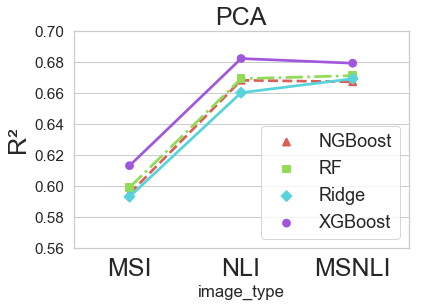

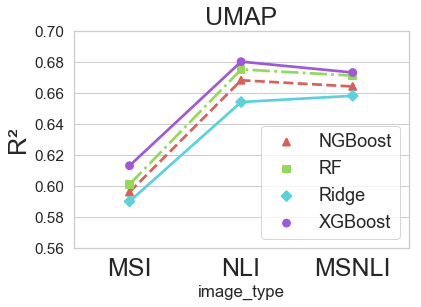

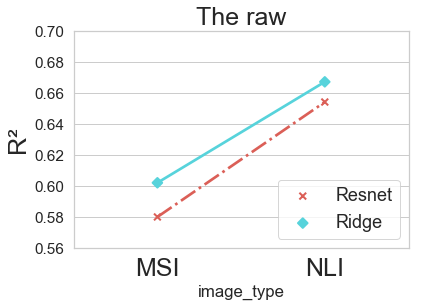

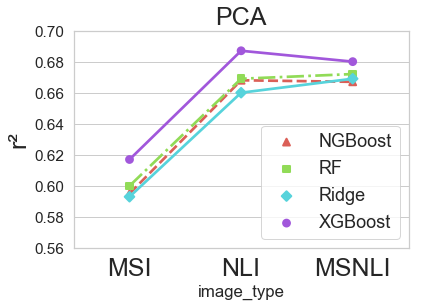

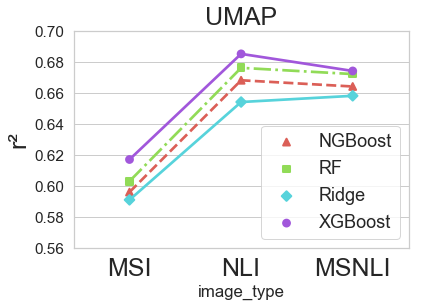

...

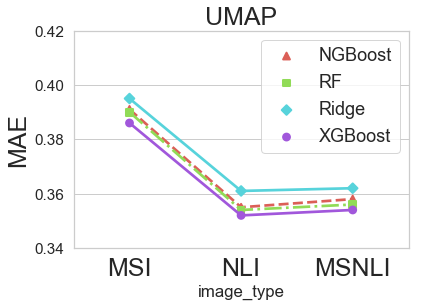

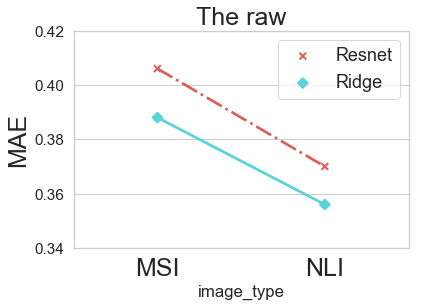

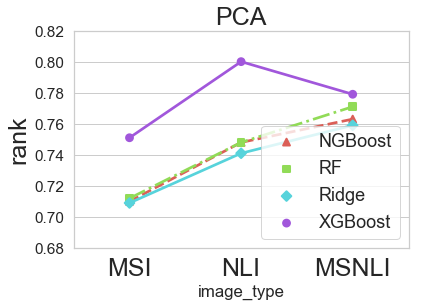

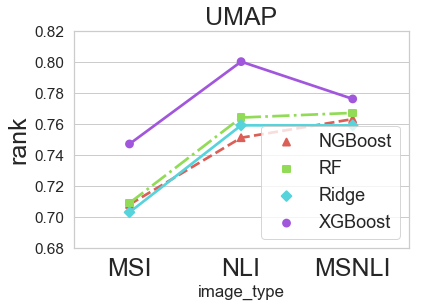

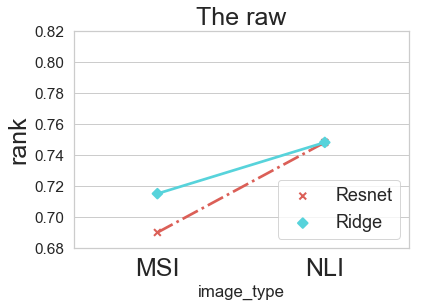

In [86]:
point_method_plot(plot_name = 'R2_PCA', data = df_PCA, indicator = 'R2', title = 'PCA', legend_loc = 'lower right')
point_method_plot(plot_name = 'R2_UMAP', data = df_UMAP, indicator = 'R2', title = 'UMAP', legend_loc = 'lower right')
point_method_plot(plot_name = 'R2_raw', data = df_raw, indicator = 'R2', title = 'The raw', legend_loc = 'lower right')

point_method_plot(plot_name = 'PCA_r2', data = df_PCA, indicator = 'r2', title = 'PCA', legend_loc = 'lower right')
point_method_plot(plot_name = 'UMAP_r2', data = df_UMAP, indicator = 'r2', title = 'UMAP', legend_loc = 'lower right')
point_method_plot(plot_name = 'raw_r2', data = df_raw, indicator = 'r2', title = 'The raw', legend_loc = 'lower right')

point_method_plot(plot_name = 'PCA_MSE', data = df_PCA, indicator = 'MSE', title = 'PCA', legend_loc = 'upper right')
point_method_plot(plot_name = 'UMAP_MSE', data = df_UMAP, indicator = 'MSE', title = 'UMAP', legend_loc = 'upper right')
point_method_plot(plot_name = 'raw_MSE', data = df_raw, indicator = 'MSE', title = 'The raw', legend_loc = 'upper right')

point_method_plot(plot_name = 'PCA_MAE', data = df_PCA, indicator = 'MAE', title = 'PCA', legend_loc = 'upper right')
point_method_plot(plot_name = 'UMAP_MAE', data = df_UMAP, indicator = 'MAE', title = 'UMAP', legend_loc = 'upper right')
point_method_plot(plot_name = 'raw_MAE', data = df_raw, indicator = 'MAE', title = 'The raw', legend_loc = 'upper right')

point_method_plot(plot_name = 'PCA_rank', data = df_PCA, indicator = 'rank', title = 'PCA', legend_loc = 'lower right')
point_method_plot(plot_name = 'UMAP_rank', data = df_UMAP, indicator = 'rank', title = 'UMAP', legend_loc = 'lower right')
point_method_plot(plot_name = 'raw_rank', data = df_raw, indicator = 'rank', title = 'The raw', legend_loc = 'lower right')

# 八、R2与国家财富的关系

In [28]:
country_effect_dir = os.path.join(OUTPUTS_ROOT_DIR,'dhs_ooc/results/plots/country_effect')
os.makedirs(country_effect_dir, exist_ok=True)

In [29]:
def country_effect(indicator, plot_name):
    sns.clustermap(data=country_df[['country', 'model', indicator]].pivot(index = "country",columns = "model",values = indicator))
    plt.savefig(os.path.join(country_effect_dir, plot_name+'.png'),dpi=500,bbox_inches = 'tight')
    plt.show()

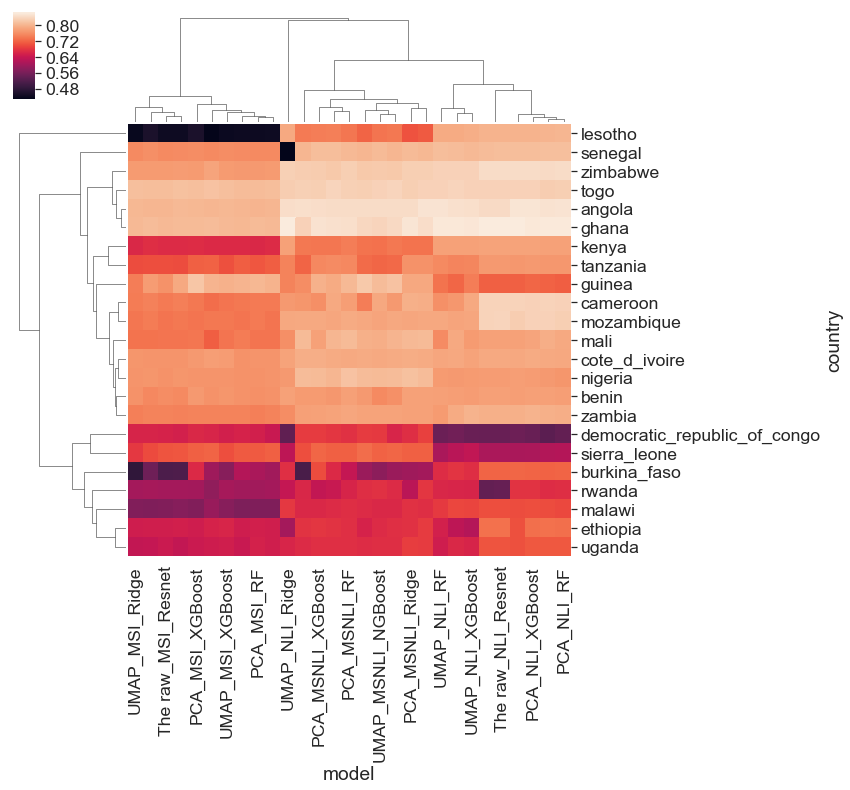

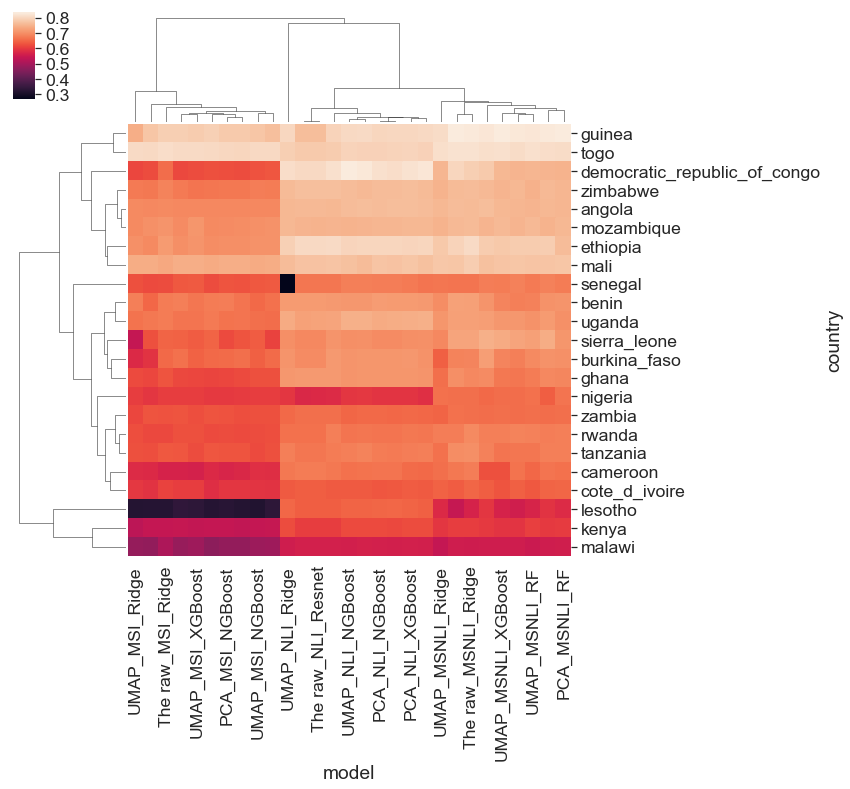

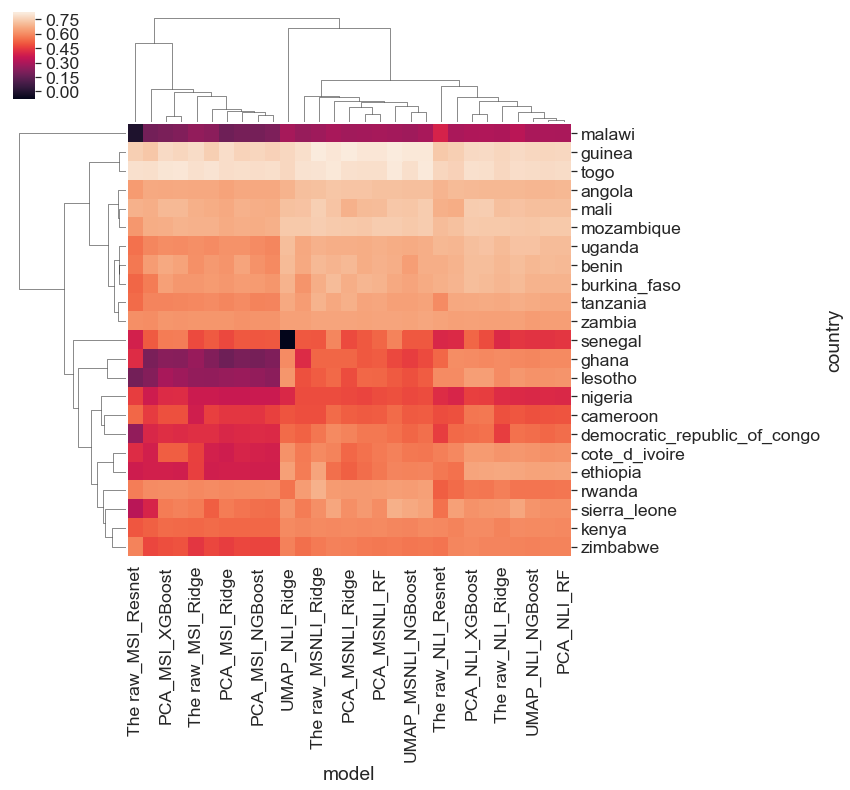

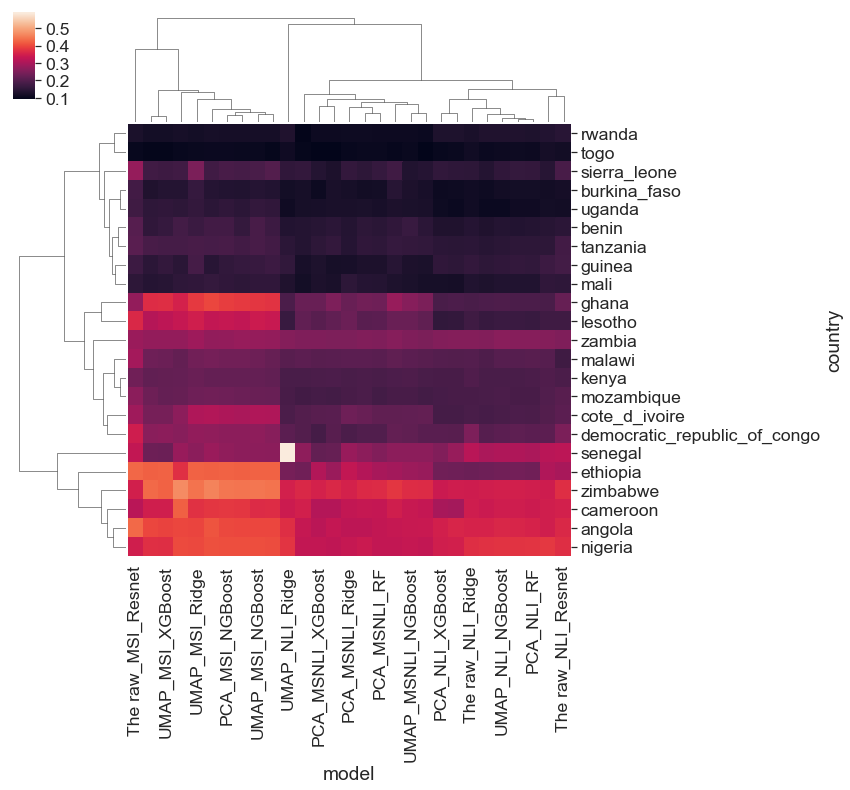

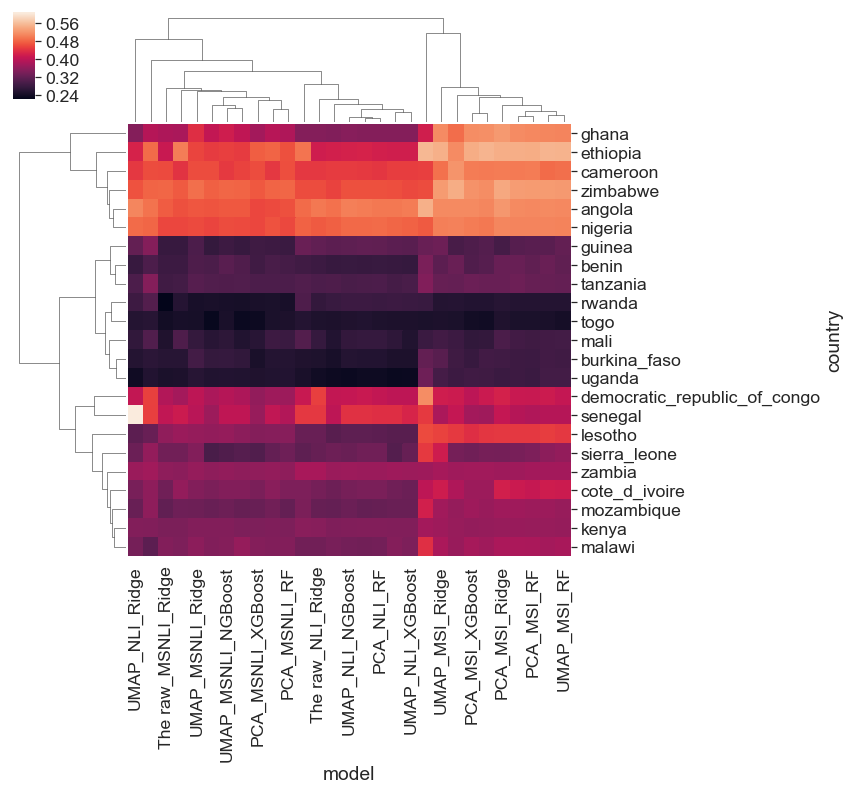

In [30]:
country_effect(indicator = 'rank', plot_name = 'rank_country_heatmap')
country_effect(indicator = 'r2', plot_name = 'r2_country_heatmap')
country_effect(indicator = 'R2', plot_name = 'R2__country_heatmap')
country_effect(indicator = 'MSE', plot_name = 'MSE_country_heatmap')
country_effect(indicator = 'MAE', plot_name = 'MAE_country_heatmap')

In [156]:
df_metric_mean = country_df.groupby('country').mean()
df_metric_mean['mean_labels'] = all_point_preds.groupby('country').mean()['labels']
df_metric_mean

,r2,R2,MSE,MAE,rank,mean_labels
country,,,,,,
angola,0.737803,0.693469,0.365980,0.495831,0.833413,0.230511
benin,0.697125,0.670156,0.156689,0.300753,0.771728,0.200553
burkina_faso,0.680535,0.662718,0.130401,0.273133,0.630026,-0.111310
cameroon,0.634183,0.493888,0.347127,0.467880,0.776291,0.297327
cote_d_ivoire,0.626701,0.537160,0.233730,0.364834,0.782852,0.477785
democratic_republic_of_congo,0.736548,0.494201,0.234237,0.409107,0.625288,-0.506605
ethiopia,0.763899,0.533752,0.323010,0.481536,0.671674,-0.450725
ghana,0.672495,0.439516,0.270772,0.420407,0.837650,0.839356
guinea,0.800312,0.781026,0.153131,0.306812,0.770911,0.101090


In [157]:
def country_indicator(color, plot_name, indicator):
    sns.set_style("white")
    sns.set_palette(sns.color_palette(color))
    g = sns.jointplot(x=indicator, y="mean_labels", data=df_metric_mean, kind="kde")
    g.plot_joint(plt.scatter, c="w", s=30, linewidth=1, marker="+")
    g.annotate(stats.pearsonr)
    plt.ylabel("wealth index")
    plt.savefig(os.path.join(country_effect_dir, plot_name+'.png'),dpi=500,bbox_inches = 'tight')
    plt.show()

C:\Users\XIAOMAN\Anaconda3\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning:

Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.

C:\Users\XIAOMAN\Anaconda3\lib\site-packages\seaborn\axisgrid.py:1847: UserWarning:

JointGrid annotation is deprecated and will be removed in a future release.



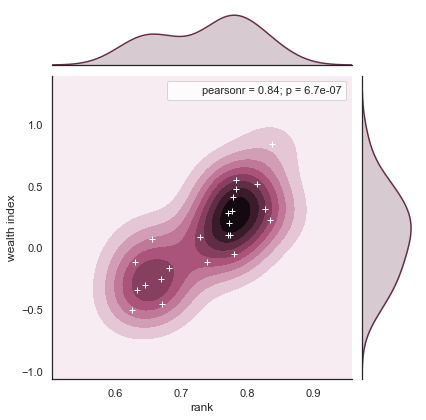

C:\Users\XIAOMAN\Anaconda3\lib\site-packages\seaborn\axisgrid.py:1847: UserWarning:

JointGrid annotation is deprecated and will be removed in a future release.



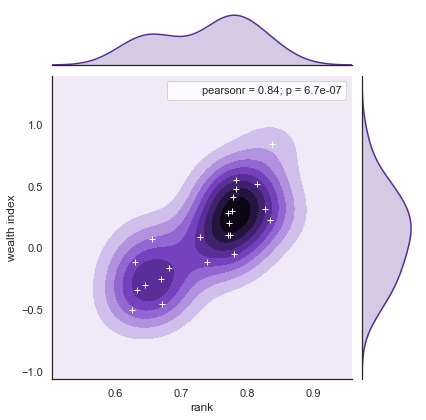

C:\Users\XIAOMAN\Anaconda3\lib\site-packages\seaborn\axisgrid.py:1847: UserWarning:

JointGrid annotation is deprecated and will be removed in a future release.



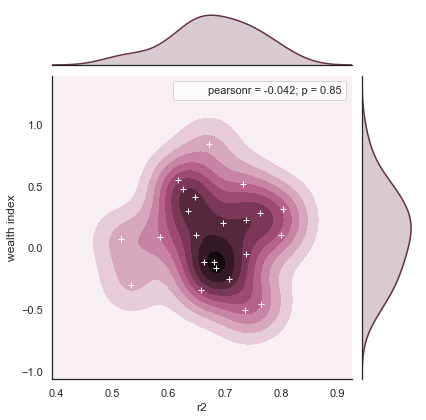

C:\Users\XIAOMAN\Anaconda3\lib\site-packages\seaborn\axisgrid.py:1847: UserWarning:

JointGrid annotation is deprecated and will be removed in a future release.



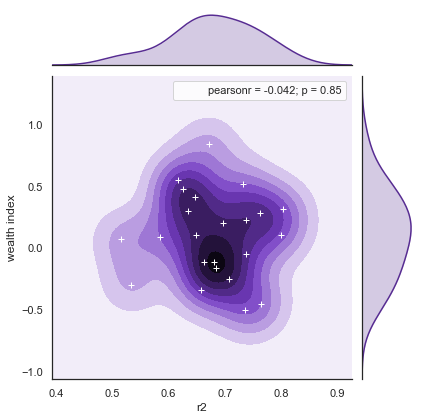

C:\Users\XIAOMAN\Anaconda3\lib\site-packages\seaborn\axisgrid.py:1847: UserWarning:

JointGrid annotation is deprecated and will be removed in a future release.



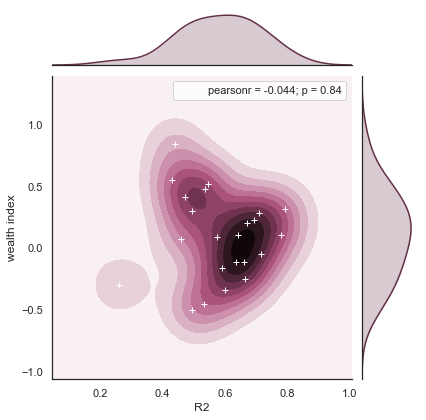

C:\Users\XIAOMAN\Anaconda3\lib\site-packages\seaborn\axisgrid.py:1847: UserWarning:

JointGrid annotation is deprecated and will be removed in a future release.



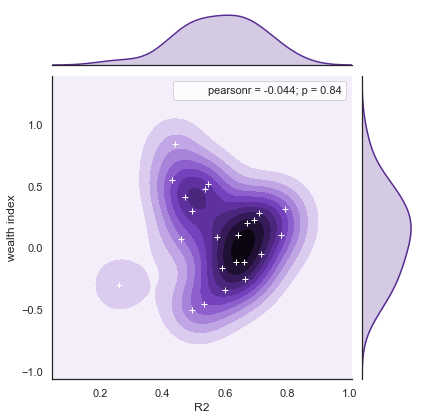

C:\Users\XIAOMAN\Anaconda3\lib\site-packages\seaborn\axisgrid.py:1847: UserWarning:

JointGrid annotation is deprecated and will be removed in a future release.



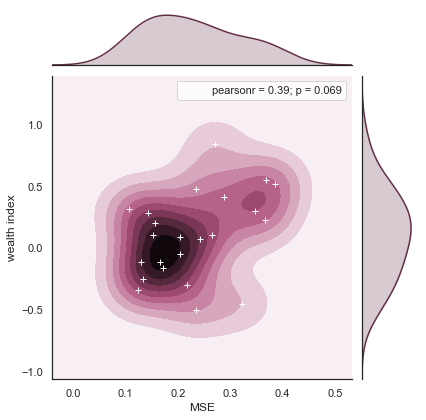

C:\Users\XIAOMAN\Anaconda3\lib\site-packages\seaborn\axisgrid.py:1847: UserWarning:

JointGrid annotation is deprecated and will be removed in a future release.



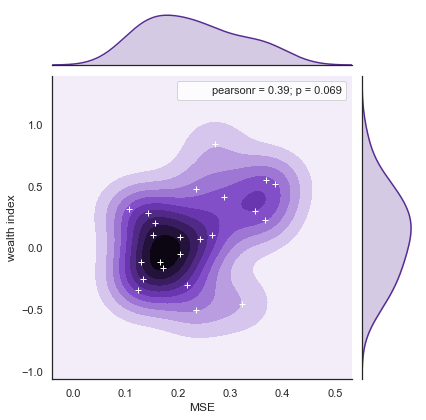

C:\Users\XIAOMAN\Anaconda3\lib\site-packages\seaborn\axisgrid.py:1847: UserWarning:

JointGrid annotation is deprecated and will be removed in a future release.



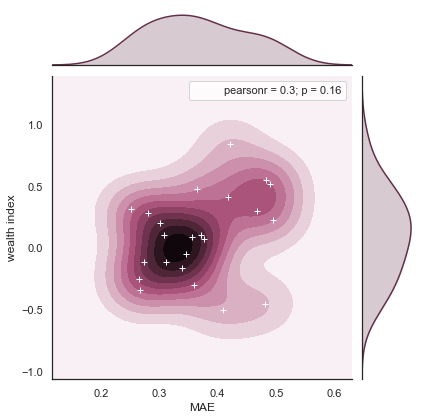

C:\Users\XIAOMAN\Anaconda3\lib\site-packages\seaborn\axisgrid.py:1847: UserWarning:

JointGrid annotation is deprecated and will be removed in a future release.



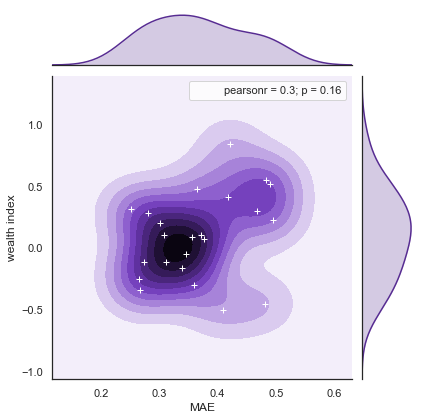

In [159]:
country_indicator(color = "PuRd_d", plot_name = 'rank_wealthindex_red', indicator = 'rank')
country_indicator(color = "Purples_r", plot_name = 'rank_wealthindex_purple', indicator = 'rank')

country_indicator(color = "PuRd_d", plot_name = 'r2_wealthindex_red', indicator = 'r2')
country_indicator(color = "Purples_r", plot_name = 'r2_wealthindex_purple', indicator = 'r2')

country_indicator(color = "PuRd_d", plot_name = 'R2__wealthindex_red', indicator = 'R2')
country_indicator(color = "Purples_r", plot_name = 'R2__wealthindex_purple', indicator = 'R2')

country_indicator(color = "PuRd_d", plot_name = 'MSE_wealthindex_red', indicator = 'MSE')
country_indicator(color = "Purples_r", plot_name = 'MSE_wealthindex_purple', indicator = 'MSE')

country_indicator(color = "PuRd_d", plot_name = 'MAE_wealthindex_red', indicator = 'MAE')
country_indicator(color = "Purples_r", plot_name = 'MAE_wealthindex_purple', indicator = 'MAE')